In [1]:
%load_ext autoreload
%autoreload 2
import sys
sys.path.insert(0, '/lab/solexa_weissman/kmin/git/spateo-release')

import anndata
import matplotlib.pyplot as plt
import numpy as np
import skimage
import sklearn
import spateo as st

plt.style.use('default')
plt.rcParams['image.interpolation'] = 'none'
%config InlineBackend.figure_format='retina'

/home/kmin/miniconda3/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(
/home/kmin/miniconda3/lib/python3.8/site-packages/spaghetti/network.py:36: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(f"{dep_msg}", FutureWarning)


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


2022-03-16 15:44:25.778250: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/nfs/lsf8/8.0/linux2.6-glibc2.3-x86_64/lib
2022-03-16 15:44:25.778292: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [2]:
%%time
adata = st.io.read_bgi_agg(
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/SS200000135TL_D1_Intron_Bin1.txt.gz',
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/SS200000135IL-D1_mrna.matched.ssDNA.tif',
    scale=0.5,
    scale_unit='um',
    gene_agg={'nuclear': ['Malat1']}
)[3000:14000,6000:20000].copy()
adata

CPU times: user 1min 10s, sys: 7.33 s, total: 1min 17s
Wall time: 1min 17s


AnnData object with n_obs × n_vars = 11000 × 14000
    uns: '__type', 'pp', 'spatial'
    layers: 'stain', 'spliced', 'unspliced', 'nuclear'

In [3]:
st.pp.segmentation.select_qc_regions(adata, seed=0)
adata.uns['spatial']['qc']

array([[ 9000, 11000,  8001, 10001],
       [11000, 13000, 10001, 12001],
       [ 7000,  9000, 14001, 16001],
       [ 7000,  9000, 12001, 14001]])

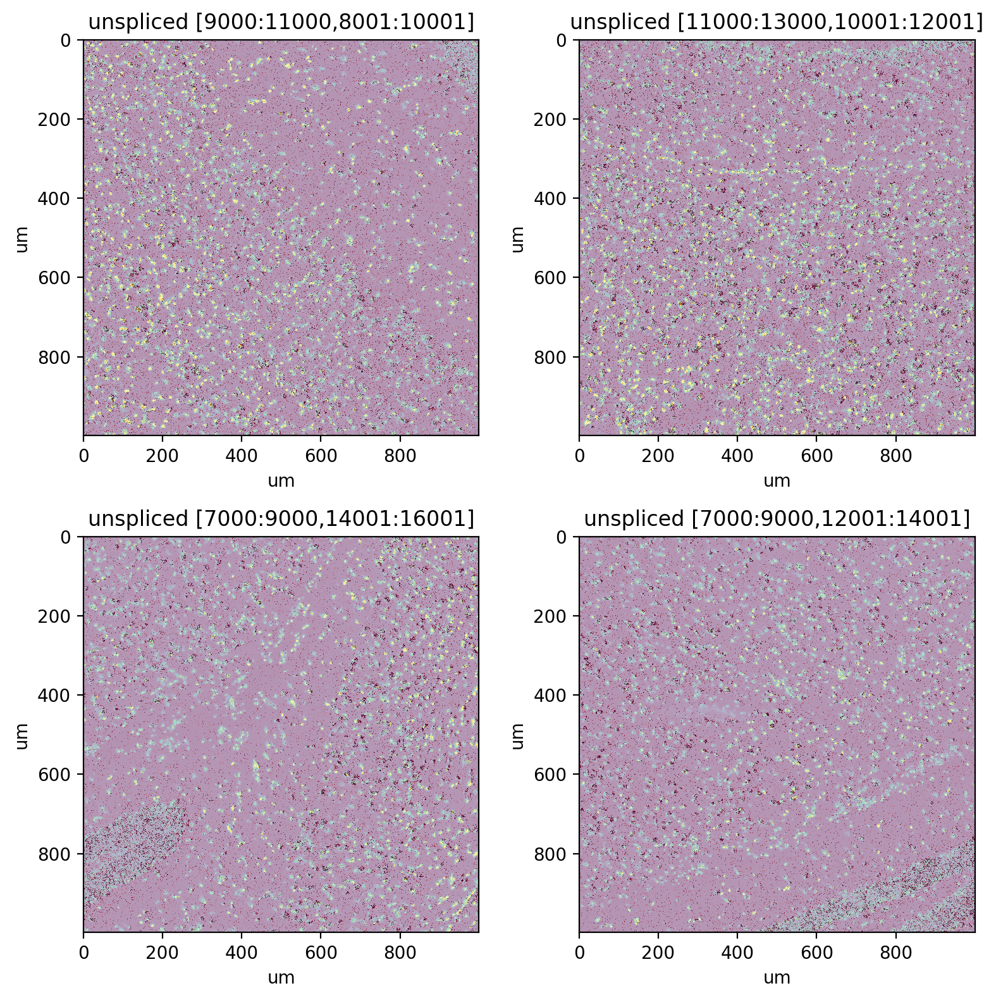

In [4]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'unspliced', axes=axes, vmax=3, alpha=0.6, cmap='Reds')

In [6]:
before = adata.layers['stain'].copy()
st.pp.segmentation.refine_alignment(adata, mode='rigid', transform_layers=['stain'], downscale=0.5)

Loss -2.6522e-03: 100%|███████████████████████████████████████████████████████████████| 100/100 [03:11<00:00,  1.92s/it]


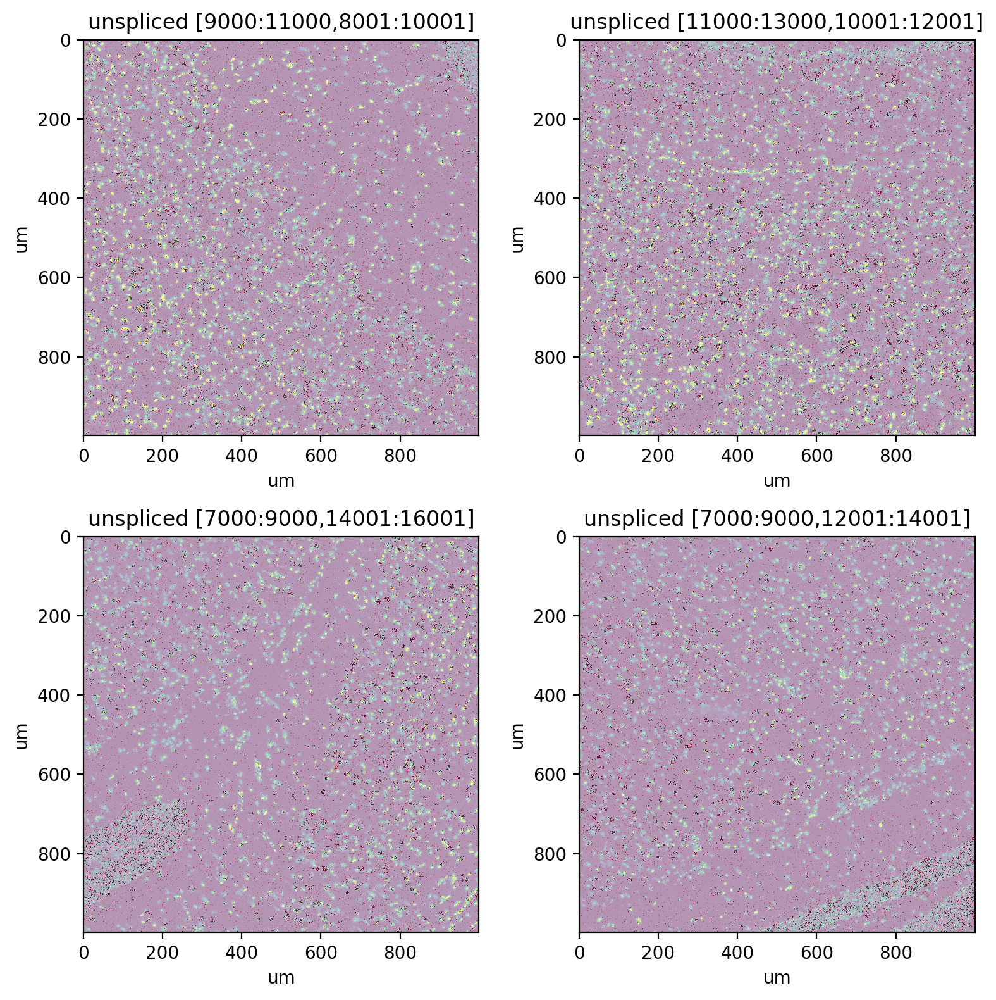

In [7]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'unspliced', axes=axes, vmax=5, alpha=0.6, cmap='Reds')

In [8]:
%%time
st.pp.segmentation.mask_nuclei_from_stain(adata)
st.pp.segmentation.watershed_markers(adata)
st.pp.segmentation.watershed(adata)

CPU times: user 1min 6s, sys: 14.7 s, total: 1min 21s
Wall time: 43.9 s


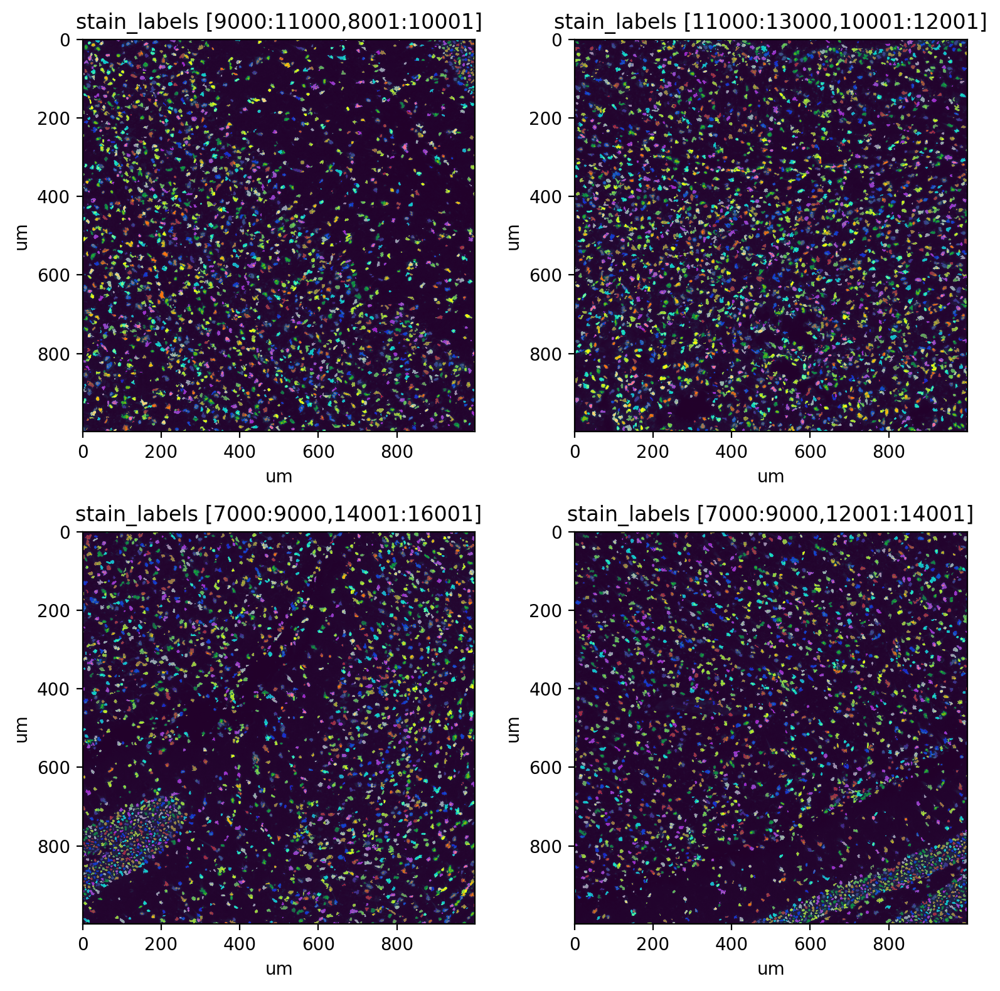

In [9]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'stain_labels', axes=axes, alpha=0.5, labels=True)

In [10]:
%%time
st.pp.segmentation.mask_cells_from_stain(adata, out_layer='stain_cell_mask')
st.pp.segmentation.watershed(
    adata,
    mask_layer='stain_cell_mask',
    markers_layer='stain_labels',
    out_layer='cell_labels',
)

CPU times: user 58.7 s, sys: 2.93 s, total: 1min 1s
Wall time: 1min 1s


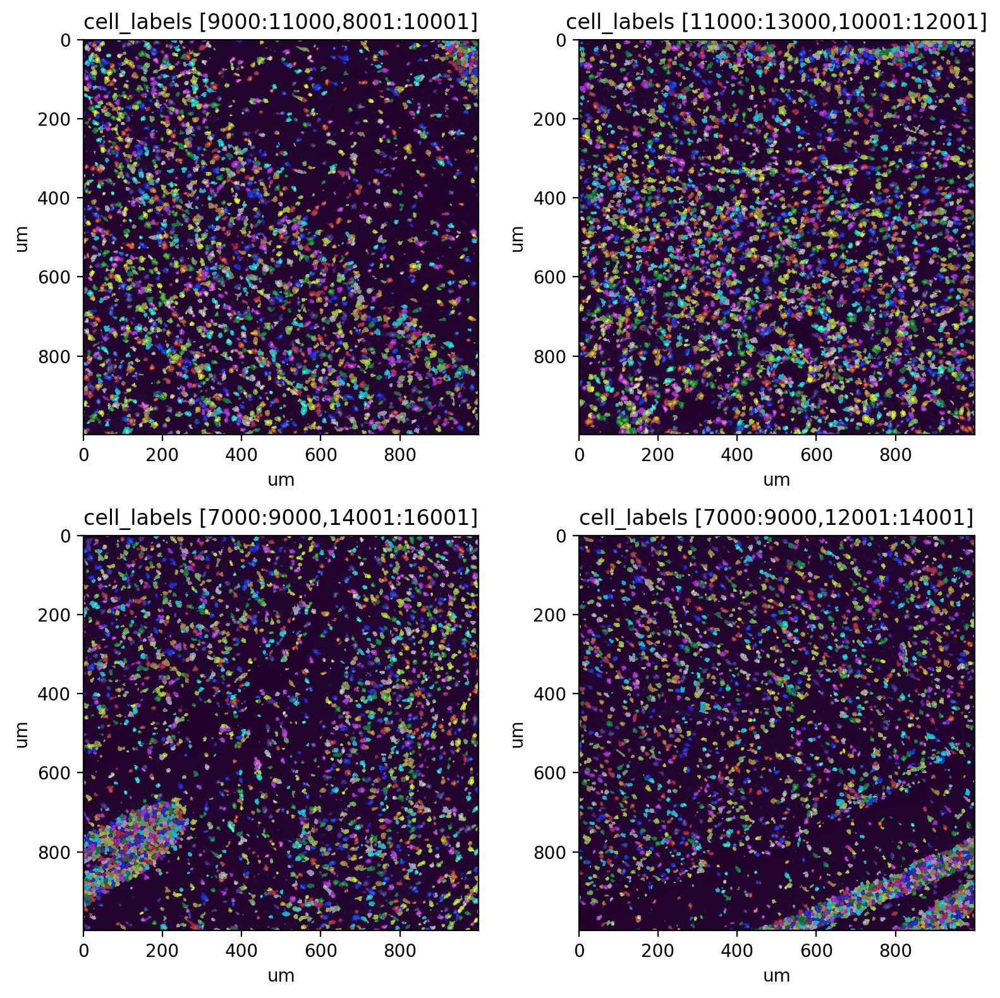

In [11]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'cell_labels', axes=axes, alpha=0.5, labels=True)

In [12]:
%%time
st.pp.segmentation.expand_labels(adata, 'cell_labels', distance=2, max_area=np.inf, out_layer='cell_labels_expanded')

CPU times: user 5min 35s, sys: 5.07 s, total: 5min 40s
Wall time: 5min 36s


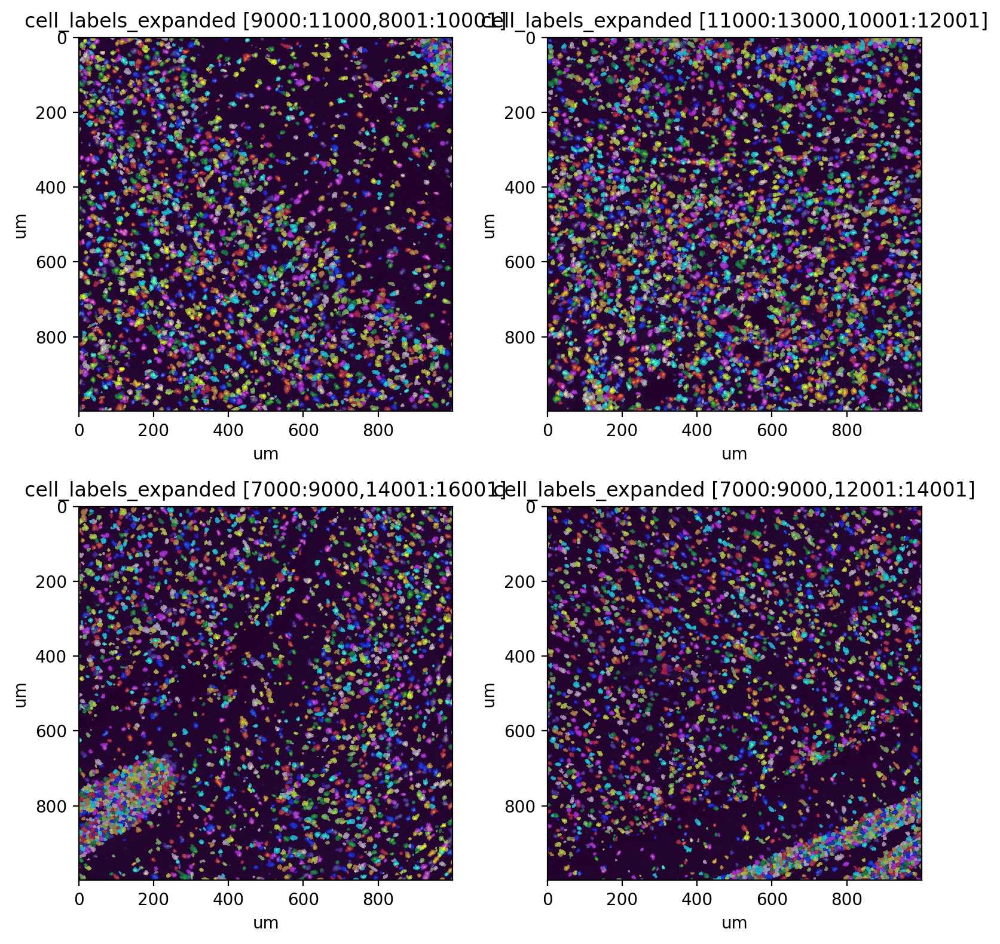

In [13]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'cell_labels_expanded', axes=axes, alpha=0.5, labels=True)

In [51]:
adata.write('data/SS200000135.h5ad', compression='gzip')

In [15]:
%%time
st.pp.segmentation.score_and_mask_pixels(
    adata, 'nuclear', k=13, method='EM+BP',
    em_kwargs=dict(downsample=0.001), bp_kwargs=dict(n_threads=16),
    mk=3  # Expected to be small
)
st.pp.segmentation.label_connected_components(adata, 'nuclear')

Running EM: 100%|########################################################################| 1/1 [03:04<00:00, 184.56s/it]


CPU times: user 10min 31s, sys: 45 s, total: 11min 16s
Wall time: 7min 27s


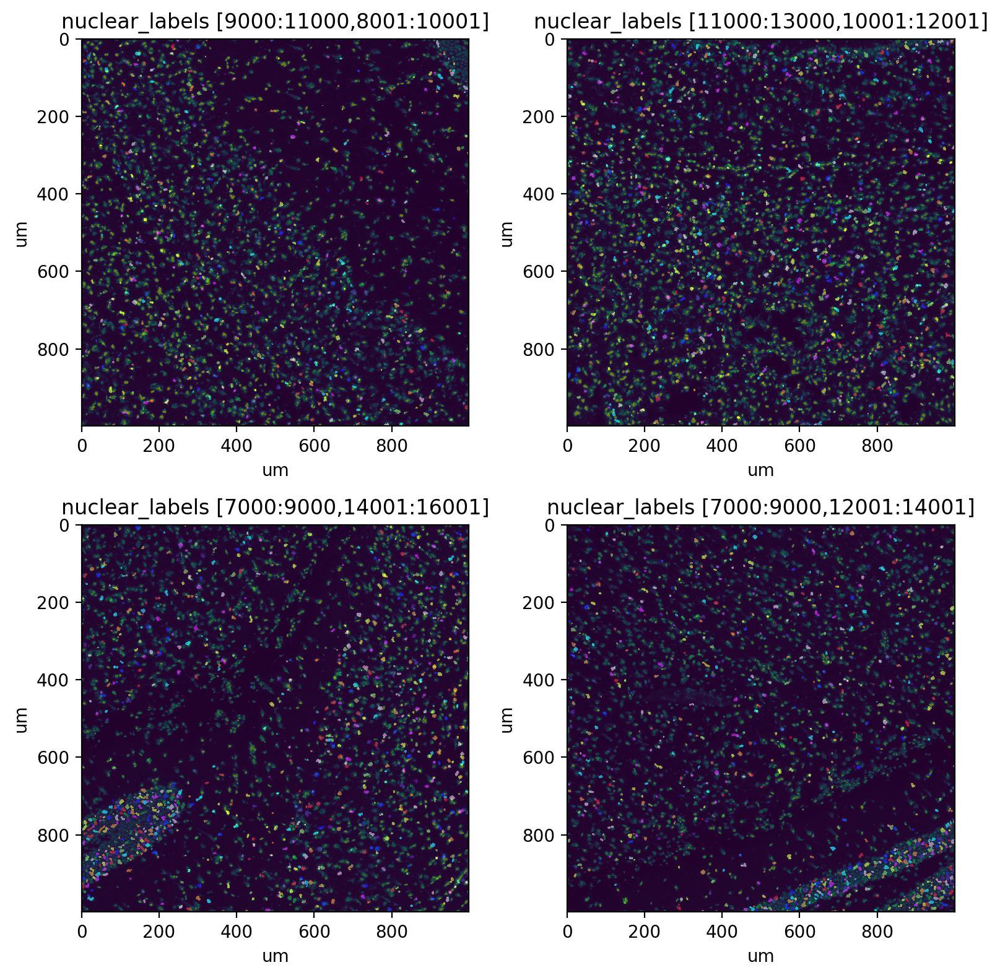

In [16]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'nuclear_labels', axes=axes, alpha=0.5, labels=True)

CPU times: user 1min 40s, sys: 4.24 s, total: 1min 44s
Wall time: 1min 42s


(<Figure size 400x400 with 1 Axes>,
 <AxesSubplot:title={'center':'unspliced_bins'}, xlabel='um', ylabel='um'>)

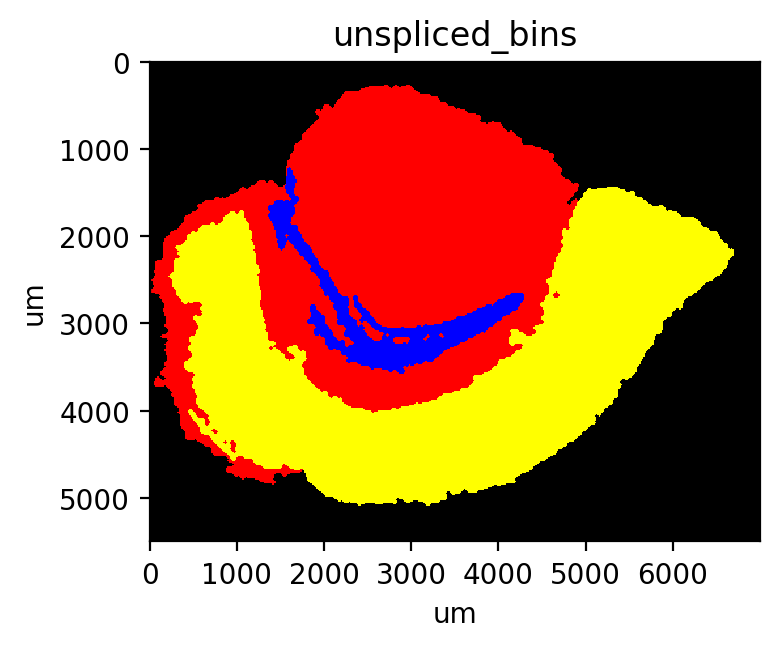

In [28]:
%%time
st.pp.segmentation.segment_densities(adata, 'unspliced', 30, k=3, dk=3, distance_threshold=3)
st.pp.segmentation.merge_densities(adata, 'unspliced_bins', {4: 3})
st.pl.imshow(adata, 'unspliced_bins', labels=True)

In [29]:
%%time
st.pp.segmentation.score_and_mask_pixels(
    adata, 'unspliced', k=13, method='EM+BP',
    em_kwargs=dict(downsample=0.001, n_threads=16), bp_kwargs=dict(n_threads=16),
    certain_layer='nuclear_labels'
)
st.pp.segmentation.label_connected_components(adata, 'unspliced', seed_layer='nuclear_labels')

Running EM:   0%|                                                                                 | 0/3 [00:00<?, ?it/s]2022-03-16 16:43:38.030511: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/nfs/lsf8/8.0/linux2.6-glibc2.3-x86_64/lib
2022-03-16 16:43:38.030545: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-03-16 16:43:38.031558: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/

CPU times: user 11min 27s, sys: 50.6 s, total: 12min 17s
Wall time: 7min 40s


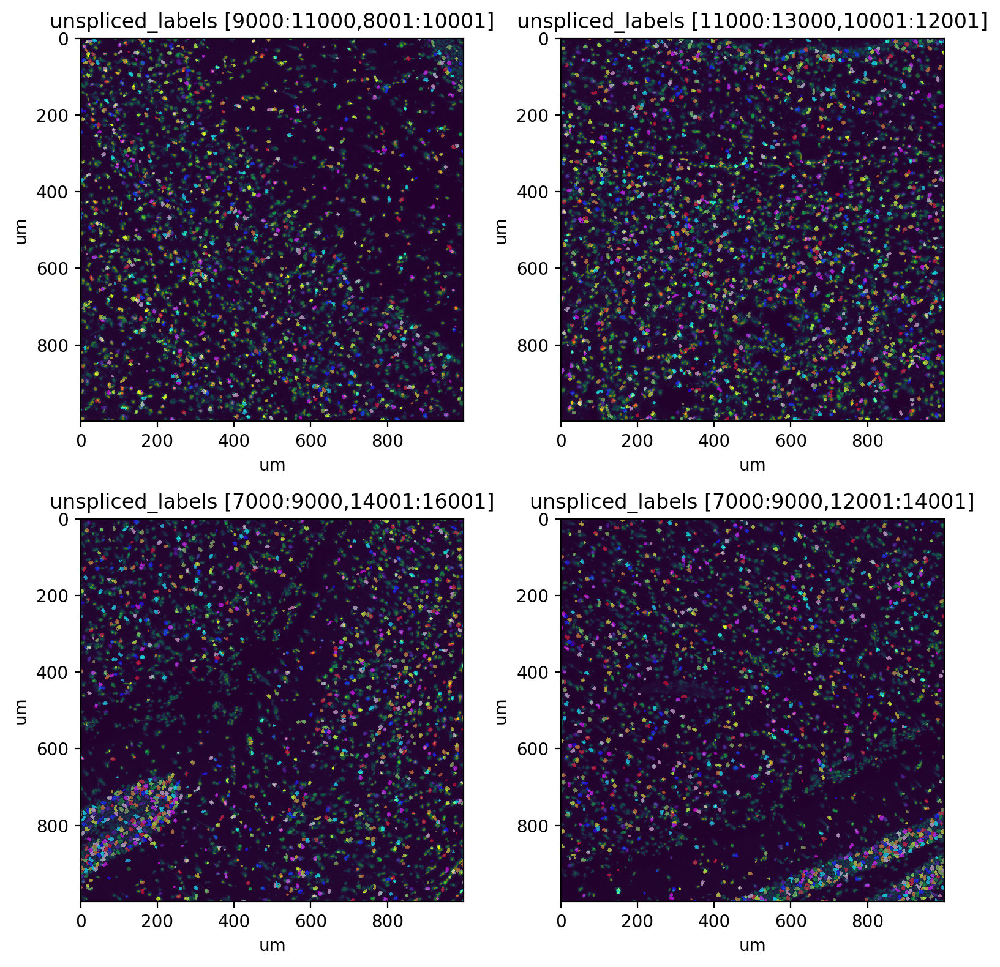

In [30]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'unspliced_labels', axes=axes, alpha=0.5, labels=True)

CPU times: user 1min 35s, sys: 6.75 s, total: 1min 41s
Wall time: 1min 38s


(<Figure size 400x400 with 1 Axes>,
 <AxesSubplot:title={'center':'X_bins'}, xlabel='um', ylabel='um'>)

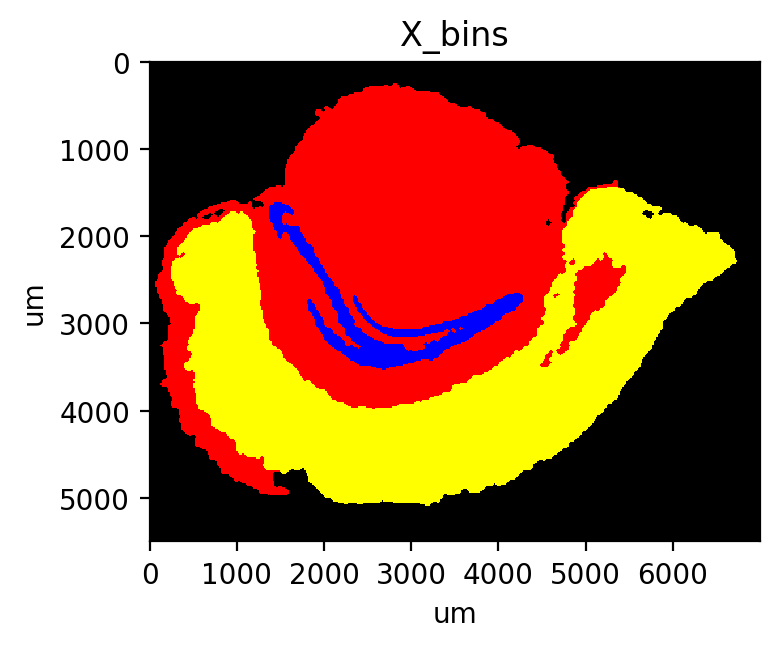

In [40]:
%%time
st.pp.segmentation.segment_densities(adata, 'X', 30, k=3, dk=3, distance_threshold=5)
st.pp.segmentation.merge_densities(adata, 'X', {4: 2, 1: 5, 6: 5, 7: 0})
st.pl.imshow(adata, 'X_bins', labels=True)

In [41]:
%%time
st.pp.segmentation.score_and_mask_pixels(
    adata, 'X', k=15, method='EM+BP',
    em_kwargs=dict(downsample=0.001, n_threads=16), bp_kwargs=dict(n_threads=16),
    certain_layer='unspliced_labels'
)
st.pp.segmentation.expand_labels(
    adata, 'unspliced', distance=5, max_area=400, mask_layer='X_mask', out_layer='X_labels'
)

Running EM:   0%|                                                                                 | 0/3 [00:00<?, ?it/s]2022-03-16 17:05:23.589389: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/lab/solexa_weissman/kmin/miniconda3/lib/python3.8/site-packages/cv2/../../lib64:/nfs/lsf8/8.0/linux2.6-glibc2.3-x86_64/lib
2022-03-16 17:05:23.589425: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-03-16 17:05:24.200713: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lab/solexa_weissman/

CPU times: user 25min 1s, sys: 55.2 s, total: 25min 56s
Wall time: 21min 37s


/home/kmin/miniconda3/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(
/home/kmin/miniconda3/lib/python3.8/site-packages/spaghetti/network.py:36: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(f"{dep_msg}", FutureWarning)
/home/kmin/miniconda3/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS ver

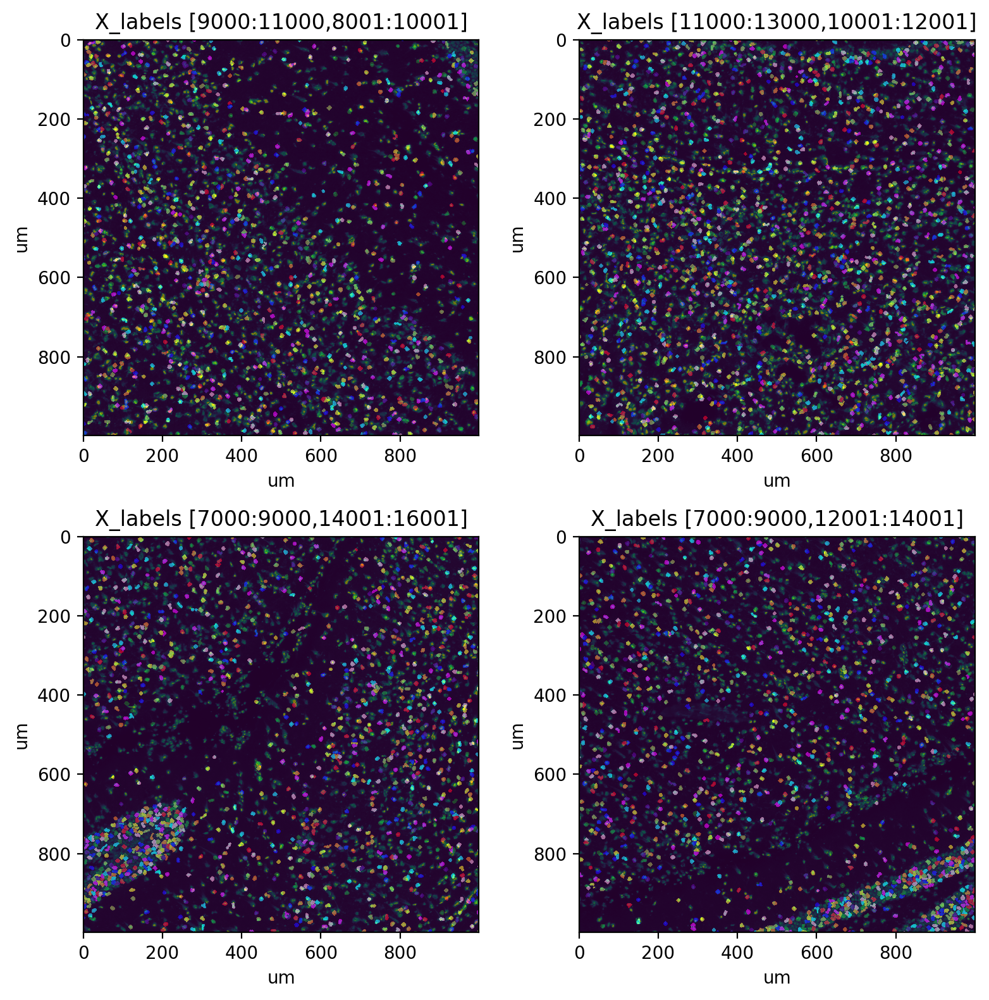

In [42]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'X_labels', axes=axes, alpha=0.5, labels=True)

In [43]:
%%time
st.pp.segmentation.expand_labels(adata, 'X', distance=2, max_area=np.inf, out_layer='X_labels_expanded')

CPU times: user 5min 24s, sys: 3.39 s, total: 5min 28s
Wall time: 5min 23s


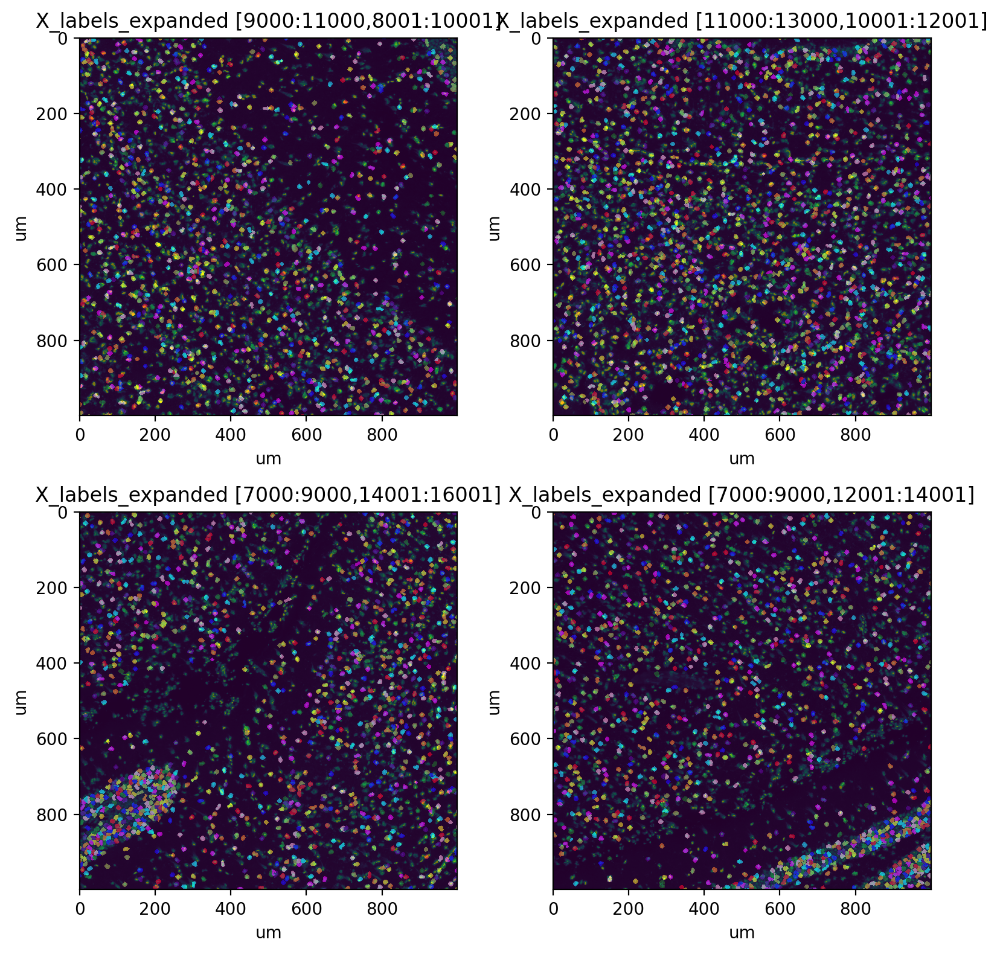

In [44]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'X_labels_expanded', axes=axes, alpha=0.5, labels=True)

In [58]:
bgi_adata = st.io.read_bgi_agg(
    '/lab/solexa_weissman/kmin/stereo/SS200000135TL_D1_CellBin_bin1.gem.gz',
    scale=0.5,
    scale_unit='um',
    label_column='label'
)

In [63]:
bgi_labels = np.zeros(
    (max(int(adata.obs_names[-1]), int(bgi_adata.obs_names[-1]))+1, max(int(adata.var_names[-1]), int(bgi_adata.var_names[-1]))+1),
    dtype=int
)
bgi_labels[
    int(bgi_adata.obs_names[0]):int(bgi_adata.obs_names[-1])+1,int(bgi_adata.var_names[0])+8:int(bgi_adata.var_names[-1])+1+8
] = bgi_adata.layers['labels'].copy()

adata.layers['labels'] = bgi_labels[
    int(adata.obs_names[0]):int(adata.obs_names[-1])+1,int(adata.var_names[0]):int(adata.var_names[-1])+1
]

In [65]:
adata.write('data/SS200000135.h5ad', compression='gzip')

In [52]:
%%time
cell_adata = st.io.read_bgi(
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/SS200000135TL_D1_Intron_Bin1.txt.gz',
    segmentation_adata=adata,
    labels_layer='cell_labels_expanded'
)
cell_adata.write('data/adata_SS200000135_cell_labels.h5ad', compression='gzip')

CPU times: user 2min 33s, sys: 8.7 s, total: 2min 42s
Wall time: 2min 41s


In [53]:
%%time
X_adata = st.io.read_bgi(
    '/lab/solexa_weissman/xqiu/proj/Aristotle/spateo_project/segmentation_paper/SS200000135TL_D1_Intron_Bin1.txt.gz',
    segmentation_adata=adata,
    labels_layer='X_labels_expanded'
)
X_adata.write('data/adata_SS200000135_X_labels', compression='gzip')

CPU times: user 1min 54s, sys: 6.92 s, total: 2min 1s
Wall time: 2min 1s


In [131]:
bgi_adata2 = st.io.read_bgi(
    '/lab/solexa_weissman/kmin/stereo/SS200000135TL_D1_CellBin_bin1.gem.gz',
    label_column='label'
)

In [54]:
import anndata
import numpy as np
import matplotlib.pyplot as plt
from sklearn import metrics
import cv2
from collections import Counter
from tqdm import tqdm
import spateo as st
import seaborn as sns
import pandas as pd
import scanpy as sc

def adjusted_rand_score(y_true, y_pred):
    (tn, fp), (fn, tp) = metrics.pair_confusion_matrix(y_true, y_pred)
    tn, tp, fp, fn =int(tn), int(tp), int(fp), int(fn)
    if fn == 0 and fp == 0:
        return 1.0
    return 2. * (tp * tn - fn * fp) / ((tp + fn) * (fn + tn) +
                                       (tp + fp) * (fp + tn))

def compute_stats(y_true, y_pred):
    y_true_bool = y_true > 0
    y_pred_bool = y_pred > 0
    pos = y_true_bool.sum()
    neg = (~y_true_bool).sum()
    
    y_true_bool_flattened = y_true_bool.flatten()
    y_pred_bool_flattened = y_pred_bool.flatten()
    tn, fp, fn, tp = metrics.confusion_matrix(y_true_bool_flattened, y_pred_bool_flattened).ravel()
    f1 = metrics.f1_score(y_true_bool_flattened, y_pred_bool_flattened)
    
    where = (y_true > 0) & (y_pred > 0)
    y_true_labels = y_true[where]
    y_pred_labels = y_pred[where]
    ars = adjusted_rand_score(y_true_labels, y_pred_labels)
    homogeneity, completeness, v = metrics.homogeneity_completeness_v_measure(y_true_labels, y_pred_labels)
    
    return tn / neg, fp / neg, fn / pos, tp / pos, f1, ars, homogeneity, completeness, v

In [55]:
stain_labels = adata.layers['stain_labels'][adata.X.A > 0]
unspliced_labels = adata.layers['unspliced_labels'][adata.X.A > 0]
compute_stats(stain_labels, unspliced_labels)

(0.9380441961343554,
 0.061955803865644615,
 0.6705606196950831,
 0.3294393803049169,
 0.398855289925044,
 0.8922277054860726,
 0.9799091351427747,
 0.9901082704633285,
 0.9849823014217767)

In [56]:
cell_labels = adata.layers['cell_labels_expanded'][adata.X.A > 0]
X_labels = adata.layers['X_labels_expanded'][adata.X.A > 0]
compute_stats(cell_labels, X_labels)

(0.9448045139554027,
 0.05519548604459731,
 0.630809391720207,
 0.369190608279793,
 0.5021521637195441,
 0.7798112238385625,
 0.9578660611750431,
 0.9790795734779271,
 0.9683566516747047)

In [133]:
sc.pp.calculate_qc_metrics(bgi_adata2, inplace=True)
sc.pp.calculate_qc_metrics(cell_adata, inplace=True)
sc.pp.calculate_qc_metrics(X_adata, inplace=True)

Text(0.5, 1.0, '598.0')

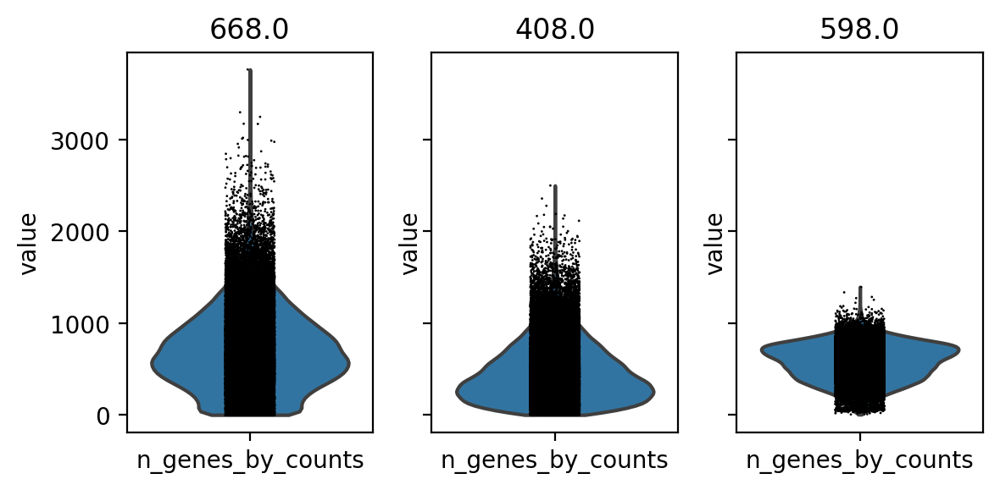

In [134]:
fig, axes = plt.subplots(ncols=3, figsize=(6, 3), tight_layout=True, sharey=True)

column = 'n_genes_by_counts'
sc.pl.violin(bgi_adata2, column, ax=axes[0], show=False)
axes[0].set_title(f'{bgi_adata2.obs[column].median()}')
sc.pl.violin(cell_adata, column, ax=axes[1], show=False)
axes[1].set_title(f'{cell_adata.obs[column].median()}')
sc.pl.violin(X_adata, column, ax=axes[2], show=False)
axes[2].set_title(f'{X_adata.obs[column].median()}')

Text(0.5, 1.0, '1517.0')

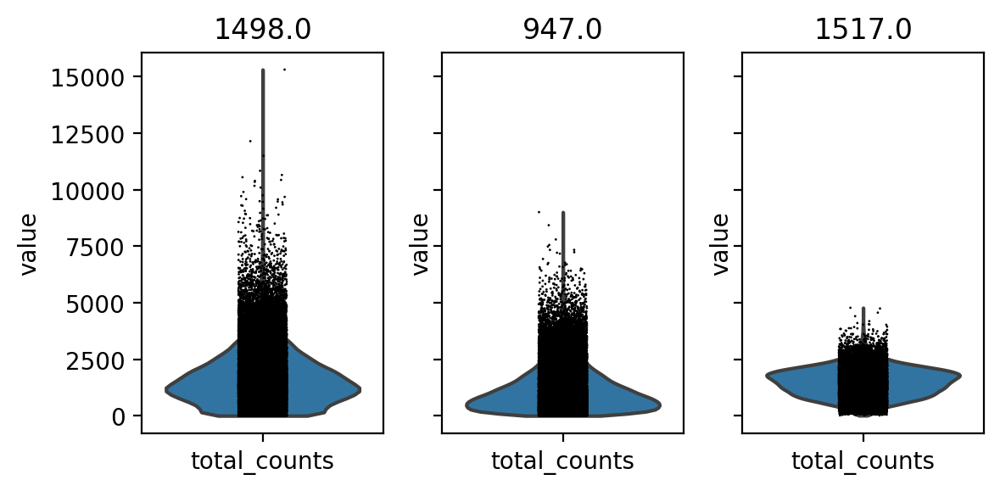

In [135]:
fig, axes = plt.subplots(ncols=3, figsize=(6, 3), tight_layout=True, sharey=True)

column = 'total_counts'
sc.pl.violin(bgi_adata2, column, ax=axes[0], show=False)
axes[0].set_title(f'{bgi_adata2.obs[column].median()}')
sc.pl.violin(cell_adata, column, ax=axes[1], show=False)
axes[1].set_title(f'{cell_adata.obs[column].median()}')
sc.pl.violin(X_adata, column, ax=axes[2], show=False)
axes[2].set_title(f'{X_adata.obs[column].median()}')